In [1]:
import pandas as pd
from dataprep.eda.distribution import plot
from dataprep.eda import create_report
import numpy as np
import warnings
warnings.filterwarnings('ignore',category=FutureWarning)

# Data Checking

## Objective
1. Focus on removing unusable data
2. Check typo
3. Generalize if possible

  0%|          | 0/1532 [00:00<?, ?it/s]

c:\Users\Rifqi-Yunus\anaconda3\Lib\site-packages\dask\core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
c:\Users\Rifqi-Yunus\anaconda3\Lib\site-packages\dask\core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


DataPrep Report
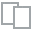
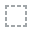
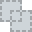
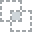
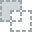
...
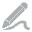
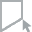
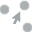
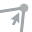
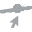

In [2]:
# Kalimantan Barat
file_path = 'data\KALBAR.xlsx'

df = pd.read_excel(file_path)
create_report(df)

In [3]:
df = df[['JAM DOWN', 'STAR DATE','KAB/KOTA', 'ROOTCAUSE', 'CUSTOMER', 'INCIDENT ID', 'TANGGAL PENGERJAAN', 'JAM UP', 'STATUS']]
df.columns = df.columns.str.lower().str.replace(' ', '_').str.replace('star','start')
df.head(20)

,jam_down,start_date,kab/kota,rootcause,customer,incident_id,tanggal_pengerjaan,jam_up,status
0,<NA>,2023-10-01,Kota Pontianak,No Action,ONGKI ADIANTO,23103100025,2023-10-01,15.07,✅
1,<NA>,2023-10-01,Kubu Raya,Patchcore Rusak,RAFIKA HIDAYAH AFTH AFTH,23093111048,2023-10-01,15.00,✅
2,<NA>,2023-10-01,KAB. KUBU RAYA,Kabel DW Rusak,ATA AHMAD HAMBALI ATA,23103100094,2023-10-01,17.00,✅
3,<NA>,2023-10-01,KOTA PONTIANAK,Putus Kabel,M RADIANSYAH,23103100285,2023-10-02,10.48,✅
4,<NA>,2023-10-02,Kubu Raya,Putus Kabel,EPA NURMALA,23103100341,2023-10-02,10.42,✅
5,<NA>,2023-10-02,KOTA PONTIANAK,Putus Kabel,APRYA MAWAR ANGGAINI,23103100338,2023-10-02,11.51,✅
6,<NA>,2023-10-01,<NA>,Masalah Konfigurasi,FTTH BACKBONE - [PROAKTIF] - IMPACT FULL TRAFF...,23103100189,2023-10-02,13.30,✅
7,<NA>,2023-10-02,<NA>,Core Crack/Bending,<Proaktif>OLT RKAL-ODC.CABINET.KAKAP-FH.AN6001...,23103100309,2023-10-02,13.34,✅
8,<NA>,2023-10-01,Kubu Raya,Putus Kabel,HISAR SIMANJUNTAK ST,23103100214,2023-10-02,15.07,✅
9,<NA>,2023-10-01,KOTA PONTIANAK,Kabel DW Rusak,SIGIT WARSITO,23103100150,2023-10-02,14.09,✅


### Clean Kota Kabupaten

In [4]:
unique_kab_kota_normal = list(df['kab/kota'].dropna().unique())
unique_kab_kota_capitalized = [item.title() for item in unique_kab_kota_normal]
set(unique_kab_kota_capitalized)

{'Kab. Kubu Raya',
 'Ketapang',
 'Ketapang ',
 'Ketapang 8,9,10',
 'Ketapang8,9,10',
 'Kota Pontianak',
 'Kota Singkawang',
 'Kubu Raya',
 'Mempawah',
 'Mempawah ',
 'Menpawah',
 'Naram',
 'Ota Pontianak',
 'Pontianak',
 'Pontianak Kota',
 'Pontianak Timur',
 'Roban',
 'Sambas',
 'Sedau',
 'Singkawang',
 'Singkawang Tengah',
 'Singkawang Utara',
 'Sungai Bangkong',
 'Sungai Kakap',
 'Sungai Rengas',
 'Wajok'}

In [5]:
corrections = {
    'Ketapang 8,9,10': 'Ketapang',
    'Ketapang8,9,10': 'Ketapang',
    'Menpawah': 'Mempawah',
    'Naram' : 'Kota Singkawang',
    'Ota Pontianak': 'Kota Pontianak',
    'Pontianak': 'Kota Pontianak',
    'Pontianak Kota': 'Kota Pontianak',
    'Singkawang': 'Kota Singkawang',
    'Kab. Kubu Raya': 'Kubu Raya',
    'Wajok' : 'Mempawah',
    'Sungai Kakap' : 'Kubu Raya',
    'Sungai Bangkong' : 'Kota Pontianak',
    'Sungai Rengas' : 'Kubu Raya',
    'Singkawang Tengah' : 'Kota Singkawang',
    'Singkawang Utara' : 'Kota Singkawang',
    'Nan': None
}

### Clean Jam dan Tanggal
Cek row with wrong data format

In [6]:
df['jam_down'] = df['jam_down'].str.strip().str.replace('.',':').str.replace(':::',':').str.replace('::',':').str.replace(',',':').str.replace('l',':')
df['jam_up'] = df['jam_up'].str.strip().str.replace('.',':').str.replace('::',':').str.replace(',',':').str.replace(' ','')

for entry in df['jam_down']:
    try:
        pd.to_datetime(entry, format='%H:%M')
    except ValueError:
        print(f"Problematic entry: {entry}")

# df_cleaned.loc[df_cleaned['jam_up'] =='17:-05',['jam_up']] = '17:05'
# df_cleaned.loc[df_cleaned['jam_up'] =='1920',['jam_up']] = '19:20'
# df_cleaned.loc[df_cleaned['jam_down'] =='9:837',['jam_down']] = '09:37'
# df_cleaned.loc[df_cleaned['jam_down'] =='0459',['jam_down']] = '04:59'
# df_cleaned.loc[df_cleaned['jam_down'] =='1808',['jam_down']] = '18:08'
# df_cleaned.loc[df_cleaned['jam_down'] =='8:01',['jam_down']] = '08:01'
# df_cleaned.loc[df_cleaned['jam_down'] =='8:09',['jam_down']] = '08:09'
# df_cleaned.loc[df_cleaned['jam_down'] =='8:31',['jam_down']] = '08:31'
# df_cleaned.loc[df_cleaned['jam_down'] =='8:41',['jam_down']] = '08:41'
# df_cleaned.loc[df_cleaned['jam_down'] =='8:52',['jam_down']] = '08:52'
# df_cleaned.loc[df_cleaned['jam_down'] =='9:40',['jam_down']] = '09:40'
# df_cleaned.loc[df_cleaned['jam_down'] =='15:166',['jam_down']] = '15:16'

Problematic entry: 0459
Problematic entry: 9:837


## Clean Final

In [7]:
# Fungsi untuk membersihkan dan memformat ulang DataFrame
def clean_data(df):
    # Filter baris dengan ikon checklist hijau pada kolom 'STATUS'
    df_cleaned = df[df['status'] == '✅'].copy()

    # Mengisi nilai NaN pada 'jam_down' dengan "00.00" dan pada 'jam_up' dengan "20.00"
    df_cleaned['jam_down'].fillna("00.00", inplace=True)
    df_cleaned['jam_up'].fillna("20.00", inplace=True)

    # Memastikan semua entri pada 'kab/kota' adalah string dan memformatnya menjadi huruf kapital awal
    df_cleaned['kab/kota'] = df_cleaned['kab/kota'].astype(str).str.title().str.strip()

    return df_cleaned

# Menerapkan fungsi pembersihan pada DataFrame
df_cleaned = clean_data(df)

# Penyesuaian dan koreksi lebih lanjut
corrections = {
    'Ketapang 8,9,10': 'Ketapang',
    'Ketapang8,9,10': 'Ketapang',
    'Menpawah': 'Mempawah',
    'Naram' : 'Kota Singkawang',
    'Ota Pontianak': 'Kota Pontianak',
    'Pontianak': 'Kota Pontianak',
    'Pontianak Kota': 'Kota Pontianak',
    'Singkawang': 'Kota Singkawang',
    'Kab. Kubu Raya': 'Kubu Raya',
    'Wajok' : 'Mempawah',
    'Sungai Kakap' : 'Kubu Raya',
    'Sungai Bangkong' : 'Kota Pontianak',
    'Sungai Rengas' : 'Kubu Raya',
    'Roban' : 'Kota Singkawang',
    'Singkawang Tengah' : 'Kota Singkawang',
    'Singkawang Utara' : 'Kota Singkawang',
    'Nan': None
}

df_cleaned['kab/kota'] = df_cleaned['kab/kota'].replace(corrections)
df_cleaned['kab/kota'] = df_cleaned['kab/kota'].str.strip()

# Mengganti nilai None dengan 'NaN' atau np.nan berdasarkan tipe data kolom
def replace_none_values(df):
    for col in df.columns:
        if df[col].dtype == 'object':  # untuk kolom string
            df[col] = df[col].replace({None: 'NaN'})
        elif np.issubdtype(df[col].dtype, np.number):  # untuk kolom numerik
            df[col] = df[col].replace({None: np.nan})
    return df

df_cleaned = replace_none_values(df_cleaned)

# Drop some false row
rows_to_drop = df_cleaned[df_cleaned['incident_id'] == 'soon']
df_cleaned = df_cleaned.drop(rows_to_drop.index)

# Memformat ulang jam_down dan jam_up
df_cleaned['jam_down'] = df_cleaned['jam_down'].str.strip().str.replace('.',':').str.replace(':::',':').str.replace('::',':').str.replace(',',':').str.replace('l',':')
df_cleaned['jam_up'] = df_cleaned['jam_up'].str.strip().str.replace('.',':').str.replace('::',':').str.replace(',',':').str.replace(' ','')

# Correction Time Values
df_cleaned.loc[df_cleaned['jam_down'] =='9:837',['jam_down']] = '09:37'
df_cleaned.loc[df_cleaned['jam_down'] =='0459',['jam_down']] = '04:59'

# Mengonversi jam_down dan jam_up menjadi format waktu
df_cleaned['jam_down'] = pd.to_datetime(df_cleaned['jam_down'], format='%H:%M').dt.time
df_cleaned['jam_up'] = pd.to_datetime(df_cleaned['jam_up'], format='%H:%M').dt.time

# Menggabungkan tanggal dengan waktu
df_cleaned['time_down'] = pd.to_datetime(df_cleaned['start_date'].astype(str) + ' ' + df_cleaned['jam_down'].astype(str), format='%Y-%m-%d %H:%M:%S', errors='coerce')
df_cleaned['time_up'] = pd.to_datetime(df_cleaned['tanggal_pengerjaan'].astype(str) + ' ' + df_cleaned['jam_up'].astype(str), format='%Y-%m-%d %H:%M:%S', errors='coerce')

df_cleaned.drop(columns=['jam_down', 'jam_up','start_date', 'tanggal_pengerjaan', 'status'], inplace=True)   
df_cleaned['customer-kota'] = df_cleaned['customer'].astype(str) + ' ' + df_cleaned['kab/kota'].astype(str)
df_cleaned

,kab/kota,rootcause,customer,incident_id,time_down,time_up,customer-kota
0,Kota Pontianak,No Action,ONGKI ADIANTO,23103100025,2023-10-01 00:00:00,2023-10-01 15:07:00,ONGKI ADIANTO Kota Pontianak
1,Kubu Raya,Patchcore Rusak,RAFIKA HIDAYAH AFTH AFTH,23093111048,2023-10-01 00:00:00,2023-10-01 15:00:00,RAFIKA HIDAYAH AFTH AFTH Kubu Raya
2,Kubu Raya,Kabel DW Rusak,ATA AHMAD HAMBALI ATA,23103100094,2023-10-01 00:00:00,2023-10-01 17:00:00,ATA AHMAD HAMBALI ATA Kubu Raya
3,Kota Pontianak,Putus Kabel,M RADIANSYAH,23103100285,2023-10-01 00:00:00,2023-10-02 10:48:00,M RADIANSYAH Kota Pontianak
4,Kubu Raya,Putus Kabel,EPA NURMALA,23103100341,2023-10-02 00:00:00,2023-10-02 10:42:00,EPA NURMALA Kubu Raya
...,...,...,...,...,...,...,...
1616,Kota Singkawang,Kabel DW Rusak,"DELSI HARIYANTO, S.PD.I",23113108807,2023-11-30 14:19:00,2023-12-01 10:51:00,"DELSI HARIYANTO, S.PD.I Kota Singkawang"
1617,Kota Singkawang,Kabel DW Rusak,USWATUN HASANAH SKW,23113108942,2023-11-30 22:34:00,2023-12-01 12:04:00,USWATUN HASANAH SKW Kota Singkawang
1618,Kota Pontianak,Kabel DW Rusak,LUKMAN,23113108953,2023-11-30 23:07:00,2023-12-02 13:00:00,LUKMAN Kota Pontianak
1619,Kota Pontianak,Kabel DW Rusak,NOVY,23123100007,2023-11-30 02:22:00,2023-12-02 11:25:00,NOVY Kota Pontianak


  0%|          | 0/582 [00:00<?, ?it/s]

c:\Users\Rifqi-Yunus\anaconda3\Lib\site-packages\dask\core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


DataPrep Report
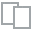
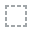
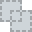
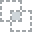
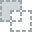
...
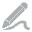
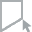
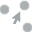
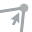
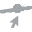

In [8]:
create_report(df_cleaned)

In [9]:
df_cleaned[df_cleaned.incident_id == '23103108518']

,kab/kota,rootcause,customer,incident_id,time_down,time_up,customer-kota
640,Kubu Raya,Putus Kabel,FREDLINA CHEN,23103108518,2023-10-26 19:00:00,2023-10-27 14:40:00,FREDLINA CHEN Kubu Raya
713,Kota Pontianak,Core Crack/Bending,VERA PUSPITA SARI,23103108518,2023-10-26 19:00:00,2023-10-31 19:20:00,VERA PUSPITA SARI Kota Pontianak


In [10]:
df_cleaned.to_excel('data/KALBAR_clean.xlsx')